#### Dataset link : https://www.kaggle.com/code/yumnammomojit/visually-similar-product-recommendation/input


In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="7"
import numpy as np
import pandas as pd
import os
import re
import tensorflow as tf
from threading import Thread
import time
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.offline import init_notebook_mode
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import Sequence
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.applications import VGG16, ResNet50, DenseNet201, Xception
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

init_notebook_mode(connected=True)

2023-05-12 23:35:07.673988: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1


In [2]:
!conda info --envs


# conda environments:
#
                         /home/saiful/anaconda3
                         /home/saiful/anaconda3/envs/base_cloned
                         /home/saiful/anaconda3/envs/biovec2
                         /home/saiful/anaconda3/envs/deeptrio
                         /home/saiful/anaconda3/envs/dlstm
                         /home/saiful/anaconda3/envs/ePPI
base                  *  /home/saiful/anaconda3/envs/fashion_reco
                         /home/saiful/anaconda3/envs/imgcap
                         /home/saiful/anaconda3/envs/pix2pix
                         /home/saiful/anaconda3/envs/progan
                         /home/saiful/anaconda3/envs/py36
                         /home/saiful/anaconda3/envs/text_summary
                         /home/saiful/anaconda3/envs/text_summary_nltk
                         /home/saiful/anaconda3/envs/triofe36
                         /home/saiful/anaconda3/envs/triofe36b
                         /home/saiful/anaconda3/envs/tri

# Product Recommendations: Visually Similar Content Filtering using KNNs


# EDA and Visualization
- Lets first merge the image data and product meta data to get the required dataset
- We will look at some of the categories and subcategories to understand which categories are more dominant

## Images Dataframe

In [3]:
images_df = pd.read_csv("/data/saiful/pilot projects/fashion-dataset/images.csv")
images_df

,filename,link
0,15970.jpg,http://assets.myntassets.com/v1/images/style/p...
1,39386.jpg,http://assets.myntassets.com/v1/images/style/p...
2,59263.jpg,http://assets.myntassets.com/v1/images/style/p...
3,21379.jpg,http://assets.myntassets.com/v1/images/style/p...
4,53759.jpg,http://assets.myntassets.com/v1/images/style/p...
...,...,...
44441,17036.jpg,http://assets.myntassets.com/v1/images/style/p...
44442,6461.jpg,http://assets.myntassets.com/v1/images/style/p...
44443,18842.jpg,http://assets.myntassets.com/v1/images/style/p...
44444,46694.jpg,http://assets.myntassets.com/v1/images/style/p...


## Product Meta Data Dataframe

In [4]:
styles_df = pd.read_csv("/data/saiful/pilot projects/fashion-dataset/styles.csv", on_bad_lines='skip')
styles_df

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt
...,...,...,...,...,...,...,...,...,...,...
44419,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,Gas Men Caddy Casual Shoe
44420,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,Lotto Men's Soccer Track Flip Flop
44421,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,Puma Men Graphic Stellar Blue Tshirt
44422,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,Rasasi Women Blue Lady Perfume


## Create Unique ID in both Dataframes

In [5]:
images_df['id'] = images_df['filename'].apply(lambda x: x.replace(".jpg","")).astype(int)

In [6]:
images_df

,filename,link,id
0,15970.jpg,http://assets.myntassets.com/v1/images/style/p...,15970
1,39386.jpg,http://assets.myntassets.com/v1/images/style/p...,39386
2,59263.jpg,http://assets.myntassets.com/v1/images/style/p...,59263
3,21379.jpg,http://assets.myntassets.com/v1/images/style/p...,21379
4,53759.jpg,http://assets.myntassets.com/v1/images/style/p...,53759
...,...,...,...
44441,17036.jpg,http://assets.myntassets.com/v1/images/style/p...,17036
44442,6461.jpg,http://assets.myntassets.com/v1/images/style/p...,6461
44443,18842.jpg,http://assets.myntassets.com/v1/images/style/p...,18842
44444,46694.jpg,http://assets.myntassets.com/v1/images/style/p...,46694


## Merging the Two Dataframes

In [7]:
data = styles_df.merge(images_df,on='id',how='left').reset_index(drop=True)
data['filename'] = data['filename'].apply(lambda x: os.path.join("/data/saiful/pilot projects/fashion-dataset/images/",x))

In [8]:
image_files = os.listdir("/data/saiful/pilot projects/fashion-dataset/images")

In [9]:
type(image_files)

list

In [10]:
image_files[:5]

['38299.jpg', '14398.jpg', '15310.jpg', '8549.jpg', '49010.jpg']

## Removing Products for which images are not present

In [11]:
data['file_found'] = data['id'].apply(lambda x: f"{x}.jpg" in image_files)

In [12]:
data = data[data['file_found']].reset_index(drop=True)

## Final Data

In [13]:
data

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName,filename,link,file_found
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,Titan Women Silver Watch,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...
44414,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,Gas Men Caddy Casual Shoe,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
44415,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,Lotto Men's Soccer Track Flip Flop,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
44416,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,Puma Men Graphic Stellar Blue Tshirt,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True
44417,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,Rasasi Women Blue Lady Perfume,/data/saiful/pilot projects/fashion-dataset/im...,http://assets.myntassets.com/v1/images/style/p...,True


## Taking only 3000 rows to save time for computation

In [14]:
# data = data.sample(n=300, random_state=42)
# data

## Checking for Null Values

In [15]:
data.isnull().sum()

id                      0
gender                  0
masterCategory          0
subCategory             0
articleType             0
baseColour             15
season                 21
year                    1
usage                 317
productDisplayName      7
filename                0
link                    0
file_found              0
dtype: int64

## Visualizations
- Main Categories Count
- Sub Categories Count
- Products by Season Count
- Product Usage type Count

In [16]:
fig = px.bar(data.groupby('masterCategory').count().reset_index(), x='masterCategory',y='id',title='Count per Product Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [17]:
fig = px.bar(data.groupby('subCategory').count().reset_index(), x='subCategory',y='id',title='Count per Product Sub-category', color='subCategory')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [18]:
fig = px.bar(data.groupby('season').count().reset_index(), x='season', y='id', title='Count per Season Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [19]:
fig = px.bar(data.groupby('usage').count().reset_index(), x='usage', y='id', title='Count per Usage Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

## Remove Unneccessary Columns
- As for now we will delete the product display name, but in the future versions of the notebook we will also use the text features

In [20]:
data.drop(columns=['productDisplayName','link','file_found'],inplace=True)
data

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,filename
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
2,59263,Women,Accessories,Watches,Watches,Silver,Winter,2016.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
...,...,...,...,...,...,...,...,...,...,...
44414,17036,Men,Footwear,Shoes,Casual Shoes,White,Summer,2013.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
44415,6461,Men,Footwear,Flip Flops,Flip Flops,Red,Summer,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
44416,18842,Men,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...
44417,46694,Women,Personal Care,Fragrance,Perfume and Body Mist,Blue,Spring,2017.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...


# Train-Val Split
- Although we won't be performing a traditional training validation approach, we still want to perform some of the steps on the training set and use those learned weights on the validation set
- Shuffle the data randomly 
- 80% data for train
- 20% data for validation

In [21]:
data = data.sample(frac=1).reset_index(drop=True)
n = len(data)
train = data.iloc[:int(n*0.8),:]
val = data.iloc[int(n*0.8):,:].reset_index(drop=True)

## Data Generator

In [22]:
datagen = ImageDataGenerator(rescale=1/255.)

train_generator = datagen.flow_from_dataframe(dataframe=train,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

val_generator = datagen.flow_from_dataframe(dataframe=val,
                                             target_size=(256,256),
                                             x_col='filename',
                                             class_mode=None,
                                             batch_size=32,
                                             shuffle=False,
                                             classes=['images'])

/home/saiful/anaconda3/envs/fashion_reco/lib/python3.7/site-packages/keras_preprocessing/image/dataframe_iterator.py:220: UserWarning:

`classes` will be ignored given the class_mode="None"



Found 35535 validated image filenames.
Found 8884 validated image filenames.


# Feature Extraction: Pre-trained VGG16 
- We will extract the features of the image using the pre-trained deep neural VGG16 network
- We will extract the final features of the network by using global average pooling on the final convolutional block of the network

In [23]:
base_model = VGG16(include_top=False,input_shape=(256,256,3))

model = Sequential()
for layer in base_model.layers:
    model.add(layer)
model.add(GlobalAveragePooling2D())
model.summary()

2023-05-12 23:35:32.497753: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-05-12 23:35:32.499456: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2023-05-12 23:35:32.562522: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:b3:00.0 name: Tesla V100-SXM2-32GB computeCapability: 7.0
coreClock: 1.53GHz coreCount: 80 deviceMemorySize: 31.75GiB deviceMemoryBandwidth: 836.37GiB/s
2023-05-12 23:35:32.562559: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2023-05-12 23:35:32.564898: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2023-05-12 23:35:32.564956: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublasLt.so.10
2

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 64, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 64, 64, 256)       2

## Extracting Features of Training and Validation Set

In [24]:
train_features = model.predict(train_generator,verbose=1)
val_features = model.predict(val_generator,verbose=1)

2023-05-12 23:35:35.146996: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2023-05-12 23:35:35.147579: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2100000000 Hz
2023-05-12 23:35:36.756732: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudnn.so.7
2023-05-12 23:35:38.408690: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10


278/278 [==============================] - 270s 970ms/step


# Dimensionality Reduction
- The features extracted using the VGG16 Network product a vector of 512 features. So if we have lets say 10000 products the matrix of our data will be of the dimension 10000 x 512
- Lets see if we can reduce the dimension of this matrix
- For a linear projection based dimensionality reduction method to work there should be high correlation amongst the features
- But to visualize a correlation coeff table of such a high dimensional matrix will be highly resource utilizing
- Lets perform the PCA and see the variance explaination of the principal components to check if our linear projection approach works

In [25]:
from sklearn.decomposition import PCA

## Illustration of how PCA finds the axes where the within data variability will be maximum
- Lets proceed with 2 principal components first so that we can visualize them in 2D
- We will then look at the Cumulative Variance Explanation to find the right amount of principal components

In [26]:
pca = PCA(2)
pca.fit(train_features)
train_pca = pca.transform(train_features)

In [27]:
test_pca = pca.fit_transform(val_features)

In [28]:
test_pca

array([[ 1.458442  , -0.12804073],
       [ 1.2676665 ,  0.3158046 ],
       [-1.3600348 ,  0.6449872 ],
       ...,
       [-1.2889467 , -0.42898464],
       [ 1.6238759 , -0.220843  ],
       [ 0.2215575 ,  0.06331616]], dtype=float32)

In [29]:
test_pca.shape

(8884, 2)

In [30]:
train_pca = pd.DataFrame(train_pca)
train = train.iloc[:,0:10]
train = train.merge(train_pca, how='left', left_index=True, right_index=True)

In [31]:
train

,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,filename,0,1
0,56825,Men,Apparel,Topwear,Shirts,Brown,Summer,2012.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,1.122161,-0.576776
1,24549,Women,Apparel,Topwear,Tops,Black,Fall,2011.0,Ethnic,/data/saiful/pilot projects/fashion-dataset/im...,1.215700,-0.341515
2,25504,Boys,Apparel,Topwear,Tshirts,Blue,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,0.013127,0.107399
3,5434,Men,Apparel,Topwear,Tshirts,Red,Summer,2011.0,Sports,/data/saiful/pilot projects/fashion-dataset/im...,0.763818,-0.068601
4,10333,Men,Accessories,Belts,Belts,Brown,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,-1.438739,-0.022099
...,...,...,...,...,...,...,...,...,...,...,...,...
35530,58902,Men,Accessories,Ties,Ties,Yellow,Summer,2012.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,-0.679542,0.908839
35531,32604,Men,Accessories,Wallets,Wallets,Brown,Spring,2013.0,NaN,/data/saiful/pilot projects/fashion-dataset/im...,-0.432246,1.301084
35532,23069,Men,Apparel,Topwear,Sweaters,Black,Fall,2011.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,1.706973,-0.437940
35533,38154,Men,Apparel,Topwear,Jackets,Black,Summer,2012.0,Casual,/data/saiful/pilot projects/fashion-dataset/im...,1.034293,-0.162870


# Visualization: Principal Components

In [32]:
fig = px.scatter(train, x=0, y=1, color="masterCategory", title='Main Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()


Scatter plot saved as scatter_plot.png


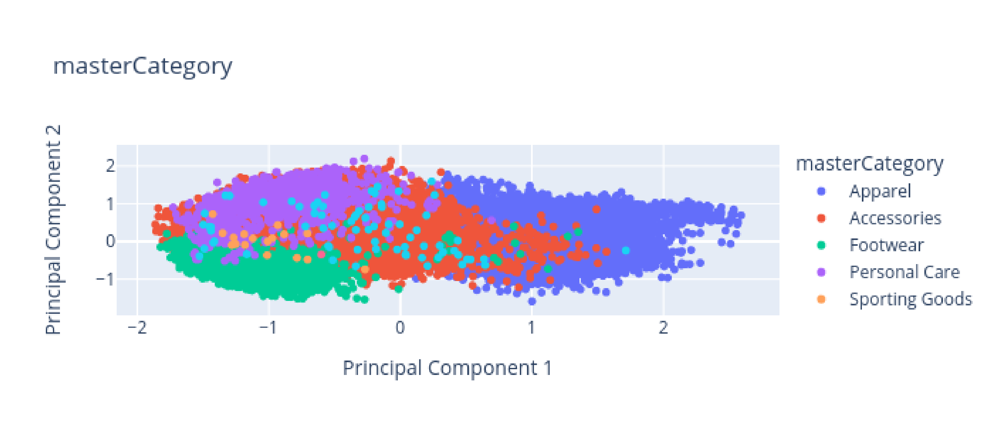

In [69]:
import plotly.express as px

# Filter the dataframe
filtered_data = train[train['masterCategory'].notna()]

# Create scatter plot
fig = px.scatter(filtered_data, x=0, y=1, color="masterCategory", title='masterCategory', height=300, labels={
                 "0": "Principal Component 1",
                 "1": "Principal Component 2"})

# Save the figure as a PNG image
fig.write_image("scatter_plot4.png")

# Display a message with the location of the saved image
print("Scatter plot saved as scatter_plot.png")

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the saved image
image_path = "scatter_plot4.png"

# Load the image
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(40, 40))

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()

In [33]:
fig = px.scatter(train, x=0, y=1, color="gender", title='Gender', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

Scatter plot saved as scatter_plot.png


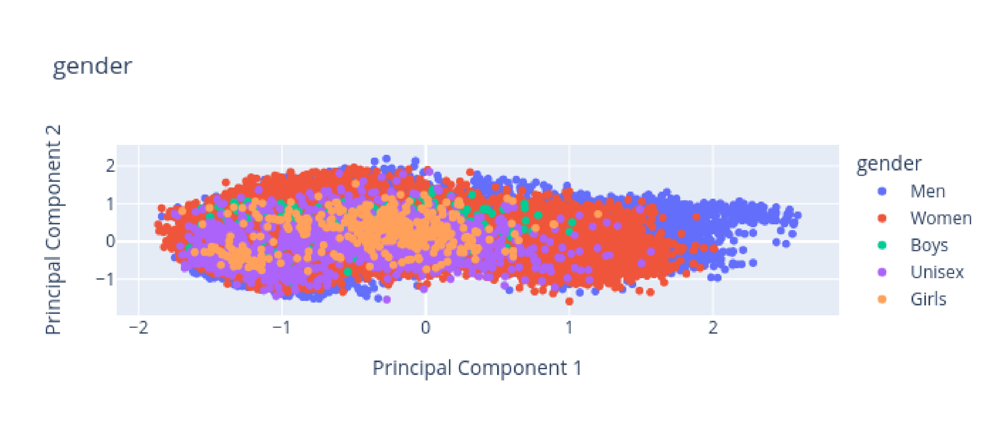

In [68]:
import plotly.express as px

# Filter the dataframe
filtered_data = train[train['gender'].notna()]

# Create scatter plot
fig = px.scatter(filtered_data, x=0, y=1, color="gender", title='gender', height=300, labels={
                 "0": "Principal Component 1",
                 "1": "Principal Component 2"})

# Save the figure as a PNG image
fig.write_image("scatter_plot3.png")

# Display a message with the location of the saved image
print("Scatter plot saved as scatter_plot.png")

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the saved image
image_path = "scatter_plot3.png"

# Load the image
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(40, 40))

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()


In [34]:
fig = px.scatter(train, x=0, y=1, color="subCategory", title='Sub Category', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

Scatter plot saved as scatter_plot.png


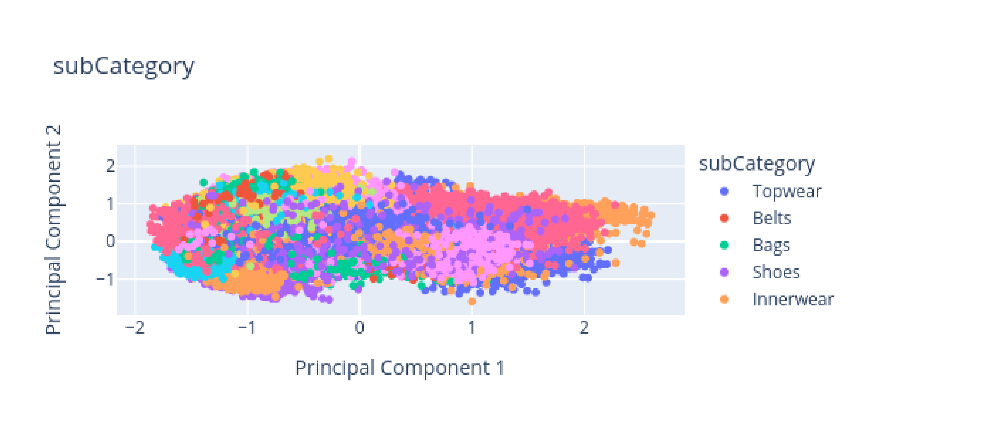

In [67]:
import plotly.express as px

# Filter the dataframe
filtered_data = train[train['subCategory'].notna()]

# Create scatter plot
fig = px.scatter(filtered_data, x=0, y=1, color="subCategory", title='subCategory', height=300, labels={
                 "0": "Principal Component 1",
                 "1": "Principal Component 2"})

# Save the figure as a PNG image
fig.write_image("scatter_plot2.png")

# Display a message with the location of the saved image
print("Scatter plot saved as scatter_plot.png")

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the saved image
image_path = "scatter_plot2.png"

# Load the image
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(40, 40))

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()


In [35]:
fig = px.scatter(train[train['season'].notna()], x=0, y=1, color="season", title='Season', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

Scatter plot saved as scatter_plot.png


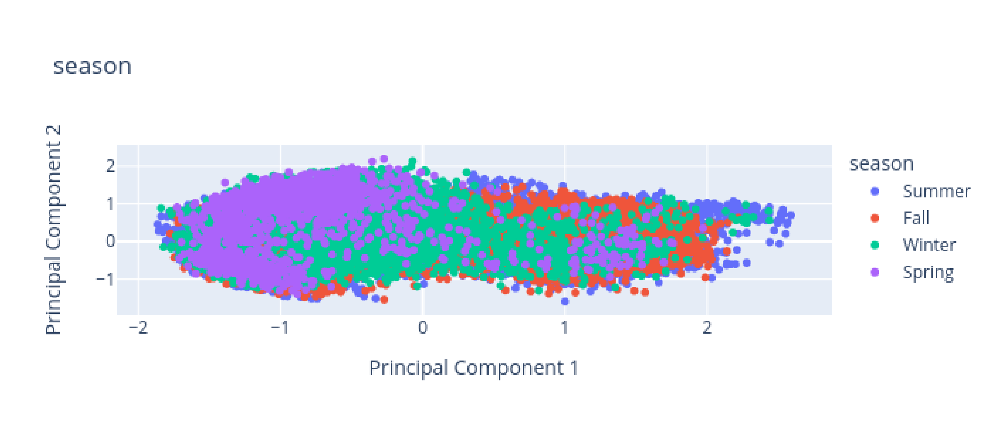

In [66]:
import plotly.express as px

# Filter the dataframe
filtered_data = train[train['season'].notna()]

# Create scatter plot
fig = px.scatter(filtered_data, x=0, y=1, color="season", title='season', height=300, labels={
                 "0": "Principal Component 1",
                 "1": "Principal Component 2"})

# Save the figure as a PNG image
fig.write_image("scatter_plot1.png")

# Display a message with the location of the saved image
print("Scatter plot saved as scatter_plot.png")

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the saved image
image_path = "scatter_plot1.png"

# Load the image
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(40, 40))

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()


In [36]:
fig = px.scatter(train[train['usage'].notna()], x=0, y=1, color="usage", title='Usage', height=600, labels={
                     "0": "Principal Component 1",
                     "1": "Principal Component 2"})
fig.show()

In [54]:
import plotly.express as px

# Filter the dataframe
filtered_data = train[train['usage'].notna()]

# Create scatter plot
fig = px.scatter(filtered_data, x=0, y=1, color="usage", title='Usage', height=300, labels={
                 "0": "Principal Component 1",
                 "1": "Principal Component 2"})

# Save the figure as a PNG image
fig.write_image("scatter_plot.png")

# Display a message with the location of the saved image
print("Scatter plot saved as scatter_plot.png")
# fig.show()

Scatter plot saved as scatter_plot.png


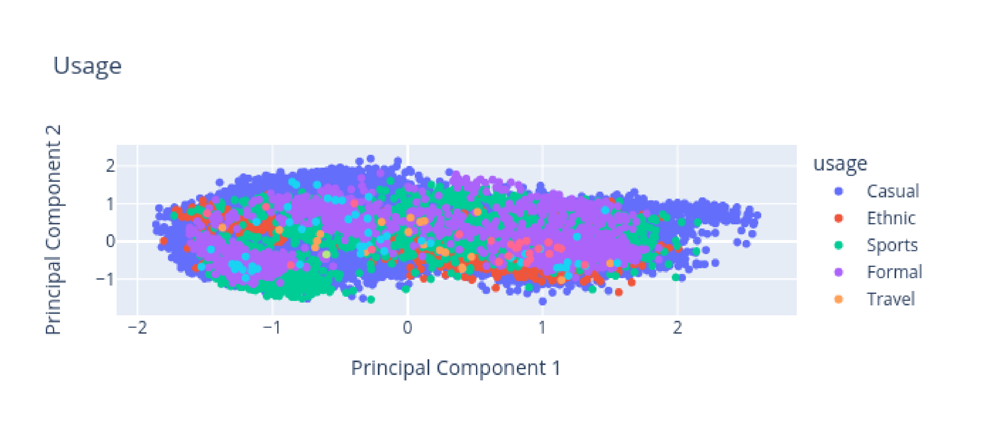

In [64]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the saved image
image_path = "scatter_plot.png"

# Load the image
image = mpimg.imread(image_path)
fig = plt.figure(figsize=(40, 40))

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()


**Inference:**
- The 2 principal components show a reasonably good separability in terms of main product categories
- Maybe after taking more principal components the seprability will be more evident

In [37]:
pca = PCA()
pca.fit(train_features)
train_pca = pca.transform(train_features)
variance_explained = np.cumsum(pca.explained_variance_ratio_)
pcs = range(1,len(variance_explained)+1)

# Reduced Dimensions: 512 -> 313
- First 313 Principal Components explain 99% of the variance in data
- We will reduce the image feature dimensions to 313

In [38]:
px.line(x = pcs, y = variance_explained, title = 'Principal Components Cumulative Explained Variance', height=600,  labels={
                     "x": "Principal Components",
                     "y": "Explained Variance"})

In [39]:
val_pca = pca.fit_transform(val_features)[:,:313]
val_pca = pd.DataFrame(val_pca)
val = val.iloc[:,0:10]
val = val.merge(val_pca, how='left', left_index=True, right_index=True)

In [40]:
X = val.iloc[:,-313:]
y = val['id']

# K-Nearest Neighbours
- Lets use k=6, to recommend 6 most similar looking products
- We choose 6 because the first product out of the 6 similar looking products will be the query product itself
- Therefore we can now look at the 5 most similar products based on raw extracted features from the pre-trained network
- We will not use the predict method for classification prediction, but the KNeighbours method to find the k or 6 most nearest neighbours which have visually similar content
- The evaluation of such recommendation techniques is usually done using something like hit-rate, which is an indicator of if the user bought the product recommended to them

In [41]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=6)
neigh.fit(X, y)

KNeighborsClassifier(n_neighbors=6)

In [42]:
def read_img(image_path):
    image = load_img(image_path,target_size=(256,256,3))
    image = img_to_array(image)
    image = image/255.
    return image

# Results
- The results can definitely improved by creating data of similar styled or branded products 
- A siamese network can then be trained to create image features where similarly styled or branded products are in closer proximity

In [43]:
import random

/home/saiful/anaconda3/envs/fashion_reco/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



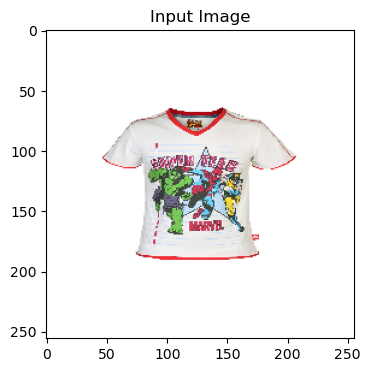

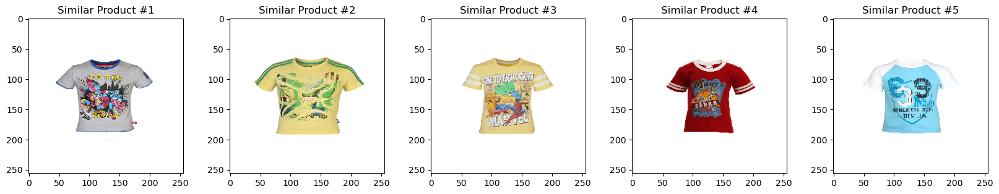

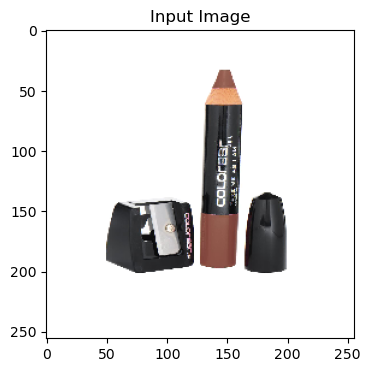

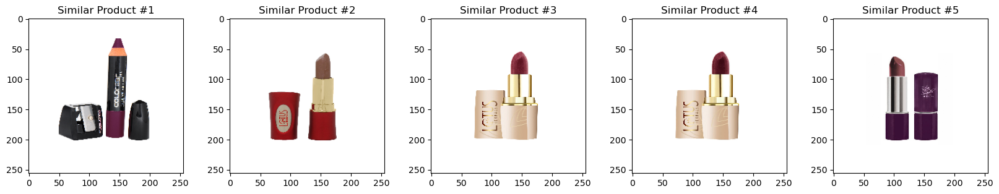

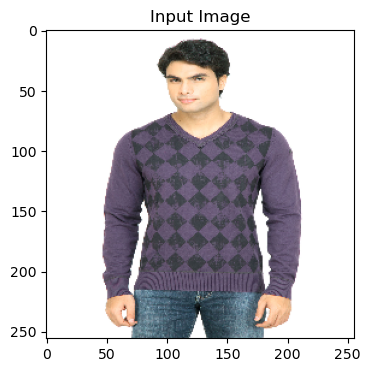

...

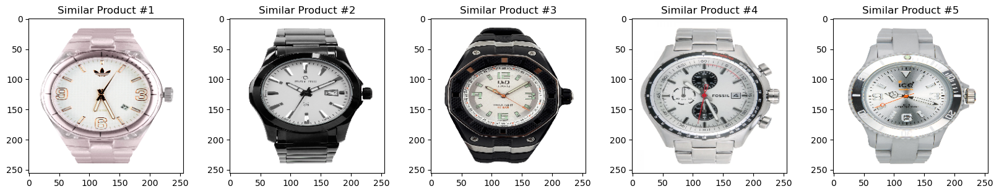

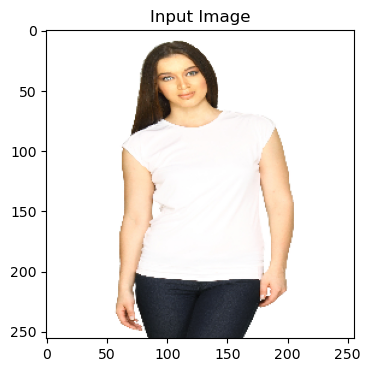

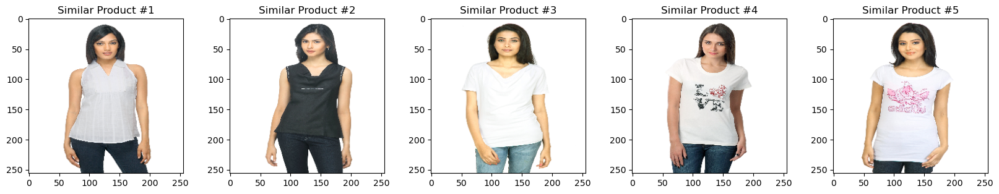

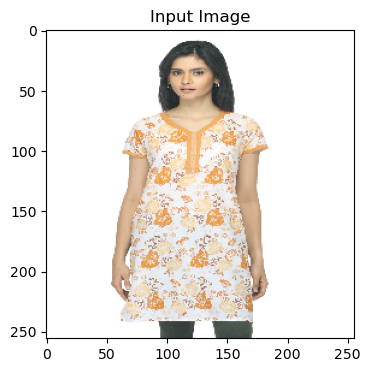

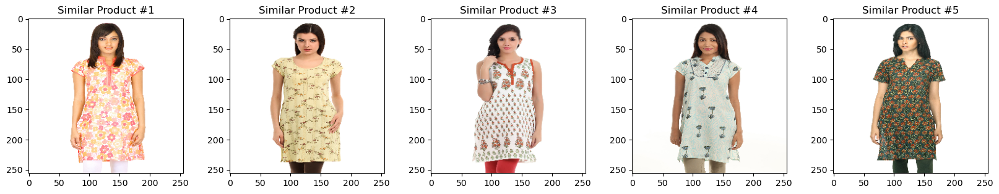

In [44]:
for _ in range(20):
    i = random.randint(1,len(val))
    img1 = read_img(val.loc[i,'filename'])
    dist, index = neigh.kneighbors(X=X.iloc[i,:].values.reshape(1,-1))
    plt.figure(figsize = (4 , 4))
    plt.imshow(img1)
    plt.title("Input Image")

    plt.figure(figsize = (20 , 20))
    for i in range(1,6):
        plt.subplot(1 , 5, i)
        plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
        image = read_img(val.loc[index[0][i],'filename'])
        plt.imshow(image)
        plt.title(f'Similar Product #{i}')

#### Reference
* https://pub.towardsai.net/product-recommendation-based-on-visual-similarity-on-the-web-machine-learning-project-end-to-end-6d38d68d414f 
* https://medium.com/geekculture/building-a-visual-similarity-based-recommendation-system-using-python-872a5bea568e
* https://www.databricks.com/blog/2022/03/01/building-a-similarity-based-image-recommendation-system-for-e-commerce.html
* https://towardsdatascience.com/find-similar-products-to-recommend-to-users-8c2f4308c2e4
* https://ieeexplore.ieee.org/document/7025614
* https://realpython.com/build-recommendation-engine-collaborative-filtering/